In [1]:
!pip install torcheval
!pip install datasets

In [2]:
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torch import optim
from PIL import Image
from torchvision import transforms
import os
import matplotlib.pyplot as plt
import numpy as np
from torcheval.metrics.functional import peak_signal_noise_ratio
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
torch.manual_seed(42)


In [3]:
from datasets import load_dataset
import torch
ds = load_dataset("pranked03/flowers-blip-captions")
dataset = ds['train'].train_test_split(test_size=0.1)

In [4]:
dataset

DatasetDict({
    train: Dataset({
        features: ['image', 'label', 'text'],
        num_rows: 5896
    })
    test: Dataset({
        features: ['image', 'label', 'text'],
        num_rows: 656
    })
})

In [5]:
type(dataset['test'][0]['image'])

PIL.JpegImagePlugin.JpegImageFile

In [6]:
BATCH_SIZE = 16
LOW_IMG_HEIGHT = 64
LOW_IMG_WIDTH = 64
HIGH_IMG_HEIGHT = 256
HIGH_IMG_WIDTH = 256

In [7]:
class FirstFeature(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(FirstFeature, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.LeakyReLU()
        )

    def forward(self, x):
        return self.conv(x)


class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ConvBlock, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(inplace=True),
        )

    def forward(self, x):
        return self.conv(x)


class Encoder(nn.Module):
    def __init__(self, in_channels, out_channels) -> None:
        super().__init__()
        self.encoder = nn.Sequential(
            nn.MaxPool2d(2),
            ConvBlock(in_channels, out_channels)
        )

    def forward(self, x):
        x = self.encoder(x)
        return x


class Decoder(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Decoder, self).__init__()
        self.conv = nn.Sequential(
            nn.UpsamplingBilinear2d(scale_factor=2),
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(),
        )
        self.conv_block = ConvBlock(in_channels, out_channels)

    def forward(self, x, skip):
        x = self.conv(x)
        x = torch.concat([x, skip], dim=1)
        x = self.conv_block(x)
        return x


class FinalOutput(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(FinalOutput, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 1, 1, 0, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        return self.conv(x)


class SR_Unet(nn.Module):
    def __init__(
            self, n_channels=3, n_classes=3
    ):
        super(SR_Unet, self).__init__()

        self.n_channels = n_channels
        self.n_classes = n_classes
        self.resize_fnc = transforms.Resize((LOW_IMG_HEIGHT*4, LOW_IMG_HEIGHT*4),
                                             antialias=True)
        self.in_conv1 = FirstFeature(n_channels, 64)
        self.in_conv2 = ConvBlock(64, 64)

        self.enc_1 = Encoder(64, 128)
        self.enc_2 = Encoder(128, 256)
        self.enc_3 = Encoder(256, 512)
        self.enc_4 = Encoder(512, 1024)

        self.dec_1 = Decoder(1024, 512)
        self.dec_2 = Decoder(512, 256)
        self.dec_3 = Decoder(256, 128)
        self.dec_4 = Decoder(128, 64)

        self.out_conv = FinalOutput(64, n_classes)


    def forward(self, x):
        x = self.resize_fnc(x)
        x = self.in_conv1(x)
        x1 = self.in_conv2(x)

        x2 = self.enc_1(x1)
        x3 = self.enc_2(x2)
        x4 = self.enc_3(x3)
        x5 = self.enc_4(x4)

        x = self.dec_1(x5, x4)
        x = self.dec_2(x, x3)
        x = self.dec_3(x, x2)
        x = self.dec_4(x, x1)

        x = self.out_conv(x)
        return x

### Prepare Super Resolution Dataset

#### Split Tran Validation data

In [8]:
class ImageDataset(Dataset):
    def __init__(self, dataset, is_train=True):
        self.in_resize = transforms.Resize((LOW_IMG_WIDTH, LOW_IMG_HEIGHT), antialias=True)
        self.out_resize = transforms.Resize((HIGH_IMG_WIDTH, HIGH_IMG_HEIGHT), antialias=True)
        self.is_train = is_train
        self.dataset = dataset  

    def __len__(self):
        return len(self.dataset)

    def normalize(self, input_image, target_image):
        input_image  = input_image * 2 - 1
        target_image = target_image * 2 - 1
        return input_image, target_image

    def random_jitter(self, input_image, target_image):
        if torch.rand([]) < 0.5:
            input_image = transforms.functional.hflip(input_image)
            target_image = transforms.functional.hflip(target_image)
        return input_image, target_image

    def __getitem__(self, idx):
        image = self.dataset[idx]['image'] 
        image = transforms.functional.to_tensor(image)

        input_image = self.in_resize(image).type(torch.float32)
        target_image = self.out_resize(image).type(torch.float32)

        input_image, target_image = self.normalize(input_image, target_image)

        if self.is_train:
            input_image, target_image = self.random_jitter(input_image, target_image)

        return input_image, target_image

In [9]:
train_dataset = ImageDataset(dataset['train'], is_train=True)
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

test_dataset = ImageDataset(dataset['test'], is_train=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

Text(0.5, 1.0, 'Target')

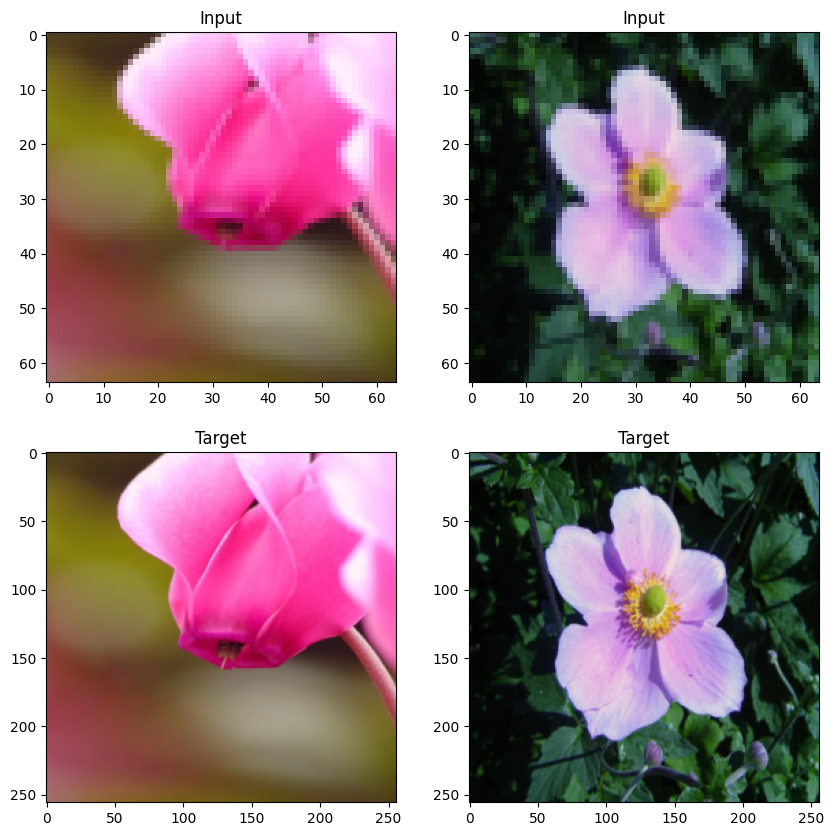

In [10]:
in_batch, tar_batch = next(iter(train_loader))
in_batch = (in_batch + 1)/2
tar_batch = (tar_batch + 1)/2

plt.figure(figsize=(10, 10))
ax = plt.subplot(2, 2, 1)
plt.imshow(np.squeeze(in_batch[0].numpy().transpose((1, 2, 0))))
plt.title("Input")
ax = plt.subplot(2, 2, 3)
plt.imshow(np.squeeze(tar_batch[0].numpy().transpose((1, 2, 0))))
plt.title("Target")
ax = plt.subplot(2, 2, 2)
plt.imshow(np.squeeze(in_batch[1].numpy().transpose((1, 2, 0))))
plt.title("Input")
ax = plt.subplot(2, 2, 4)
plt.imshow(np.squeeze(tar_batch[1].numpy().transpose((1, 2, 0))))
plt.title("Target")



### Train

In [11]:
def generate_images(model, inputs, labels):
    model.eval()
    with torch.no_grad():
        inputs, labels = inputs.to(device), labels.to(device)
        predictions = model(inputs)
    inputs, labels, predictions = inputs.cpu().numpy(), labels.cpu().numpy(), predictions.cpu().numpy()
    plt.figure(figsize=(15,20))

    display_list = [inputs[-1].transpose((1, 2, 0)), labels[-1].transpose((1, 2, 0)), predictions[-1].transpose((1, 2, 0))]
    title = ['Input', 'Real', 'Predicted']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] + 1) / 2)
        plt.axis('off')
    plt.show()

In [12]:
import time

def train_epoch(model, optimizer, criterion, train_dataloader, device, epoch=0,
                log_interval=50):
    model.train()
    total_psnr, total_count = 0, 0
    losses = []
    start_time = time.time()

    for idx, (inputs, labels) in enumerate(train_dataloader):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        predictions = model(inputs)

        # compute loss
        loss = criterion(predictions, labels)
        losses.append(loss.item())

        # backward
        loss.backward()
        optimizer.step()

        total_psnr += peak_signal_noise_ratio(predictions, labels)
        total_count += 1
        if idx % log_interval == 0 and idx > 0:
            elapsed = time.time() - start_time
            print(
                "| epoch {:3d} | {:5d}/{:5d} batches "
                "| psnr {:8.3f}".format(
                    epoch, idx, len(train_dataloader), total_psnr / total_count
                )
            )
            total_psnr, total_count = 0, 0
            start_time = time.time()

    epoch_psnr = total_psnr / total_count
    epoch_loss = sum(losses) / len(losses)
    return epoch_psnr, epoch_loss

In [13]:
def evaluate_epoch(model, criterion, valid_dataloader, device):
    model.eval()
    total_psnr, total_count = 0, 0
    losses = []

    with torch.no_grad():
        for idx, (inputs, labels) in enumerate(valid_dataloader):
            inputs = inputs.to(device)
            labels = labels.to(device)

            predictions = model(inputs)

            loss = criterion(predictions, labels)
            losses.append(loss.item())


            total_psnr +=  peak_signal_noise_ratio(predictions, labels)
            total_count += 1

    epoch_psnr = total_psnr / total_count
    epoch_loss = sum(losses) / len(losses)
    return epoch_psnr, epoch_loss

In [14]:
def train(model, model_name, save_model, optimizer, criterion, train_dataloader, valid_dataloader, num_epochs, device):
    train_psnrs, train_losses = [], []
    eval_psnrs, eval_losses = [], []
    best_psnr_eval = -1000
    times = []
    for epoch in range(1, num_epochs+1):
        epoch_start_time = time.time()
        # Training
        train_psnr, train_loss = train_epoch(model, optimizer, criterion, train_dataloader, device, epoch)
        train_psnrs.append(train_psnr.cpu())
        train_losses.append(train_loss)

        # Evaluation
        eval_psnr, eval_loss = evaluate_epoch(model, criterion, valid_dataloader, device)
        eval_psnrs.append(eval_psnr.cpu())
        eval_losses.append(eval_loss)

        # Save best model
        if best_psnr_eval < eval_psnr :
            torch.save(model.state_dict(), save_model + f'/{model_name}.pt')
            inputs_t, targets_t = next(iter(valid_dataloader))
            generate_images(model, inputs_t, targets_t)
            best_psnr_eval = eval_psnr
        times.append(time.time() - epoch_start_time)
        # Print loss, psnr end epoch
        print("-" * 59)
        print(
            "| End of epoch {:3d} | Time: {:5.2f}s | Train psnr {:8.3f} | Train Loss {:8.3f} "
            "| Valid psnr {:8.3f} | Valid Loss {:8.3f} ".format(
                epoch, time.time() - epoch_start_time, train_psnr, train_loss, eval_psnr, eval_loss
            )
        )
        print("-" * 59)

    # Load best model
    model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))
    model.eval()
    metrics = {
        'train_psnr': train_psnrs,
        'train_loss': train_losses,
        'valid_psnr': eval_psnrs,
        'valid_loss': eval_losses,
        'time': times
    }
    return model, metrics

In [15]:
import matplotlib.pyplot as plt

def plot_result(num_epochs, train_psnrs, eval_psnrs, train_losses, eval_losses):
    epochs = list(range(num_epochs))
    fig, axs = plt.subplots(nrows = 1, ncols =2 , figsize = (12,6))
    axs[0].plot(epochs, train_psnrs, label = "Training")
    axs[0].plot(epochs, eval_psnrs, label = "Evaluation")
    axs[1].plot(epochs, train_losses, label = "Training")
    axs[1].plot(epochs, eval_losses, label = "Evaluation")
    axs[0].set_xlabel("Epochs")
    axs[1].set_xlabel("Epochs")
    axs[0].set_ylabel("PSNR")
    axs[1].set_ylabel("Loss")
    plt.legend()

In [16]:
import matplotlib.pyplot as plt

def predict_and_display(model, test_dataloader, device):
    model.eval()

    with torch.no_grad():
        for idx, (inputs, labels) in enumerate(test_dataloader):
            if idx >= 10:
                break
            inputs = inputs.to(device)
            predictions = model(inputs)
            generate_images(model, inputs, labels)
            plt.show()


# Usage example:
# predict_and_display(model, test_dataloader, device)


#### Unet

| epoch   1 |    50/  369 batches | psnr   18.432
| epoch   1 |   100/  369 batches | psnr   21.938
| epoch   1 |   150/  369 batches | psnr   23.065
| epoch   1 |   200/  369 batches | psnr   23.924
| epoch   1 |   250/  369 batches | psnr   24.376
| epoch   1 |   300/  369 batches | psnr   24.647
| epoch   1 |   350/  369 batches | psnr   24.849


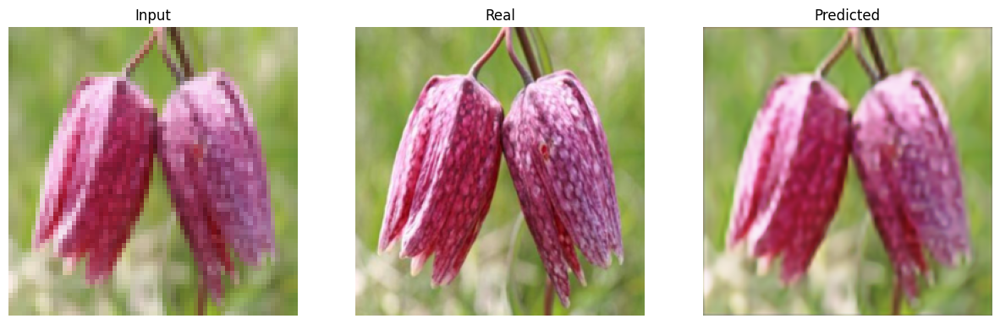

-----------------------------------------------------------
| End of epoch   1 | Time: 218.51s | Train psnr   25.209 | Train Loss    0.108 | Valid psnr   25.817 | Valid Loss    0.069 
-----------------------------------------------------------
| epoch   2 |    50/  369 batches | psnr   25.268
| epoch   2 |   100/  369 batches | psnr   25.316
| epoch   2 |   150/  369 batches | psnr   25.516
| epoch   2 |   200/  369 batches | psnr   25.766
| epoch   2 |   250/  369 batches | psnr   25.762
| epoch   2 |   300/  369 batches | psnr   25.972
| epoch   2 |   350/  369 batches | psnr   25.925


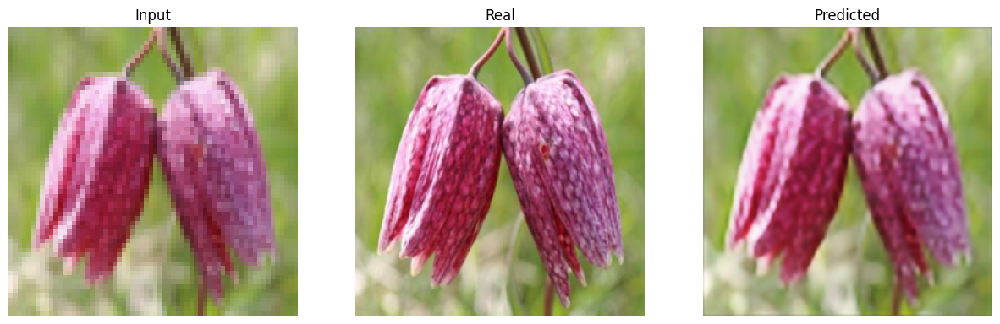

-----------------------------------------------------------
| End of epoch   2 | Time: 217.45s | Train psnr   26.145 | Train Loss    0.072 | Valid psnr   26.563 | Valid Loss    0.060 
-----------------------------------------------------------
| epoch   3 |    50/  369 batches | psnr   26.186
| epoch   3 |   100/  369 batches | psnr   26.129
| epoch   3 |   150/  369 batches | psnr   26.307
| epoch   3 |   200/  369 batches | psnr   26.172
| epoch   3 |   250/  369 batches | psnr   26.410
| epoch   3 |   300/  369 batches | psnr   26.578
| epoch   3 |   350/  369 batches | psnr   26.362
-----------------------------------------------------------
| End of epoch   3 | Time: 216.54s | Train psnr   26.084 | Train Loss    0.066 | Valid psnr   26.160 | Valid Loss    0.067 
-----------------------------------------------------------
| epoch   4 |    50/  369 batches | psnr   26.557
| epoch   4 |   100/  369 batches | psnr   26.823
| epoch   4 |   150/  369 batches | psnr   26.756
| epoch   4 

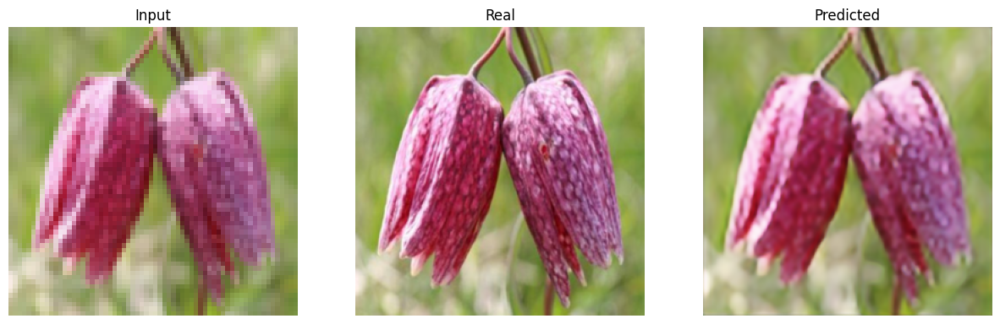

-----------------------------------------------------------
| End of epoch   4 | Time: 217.58s | Train psnr   26.478 | Train Loss    0.063 | Valid psnr   26.839 | Valid Loss    0.059 
-----------------------------------------------------------
| epoch   5 |    50/  369 batches | psnr   26.688
| epoch   5 |   100/  369 batches | psnr   27.050
| epoch   5 |   150/  369 batches | psnr   26.973
| epoch   5 |   200/  369 batches | psnr   26.544
| epoch   5 |   250/  369 batches | psnr   26.944
| epoch   5 |   300/  369 batches | psnr   26.854
| epoch   5 |   350/  369 batches | psnr   27.110


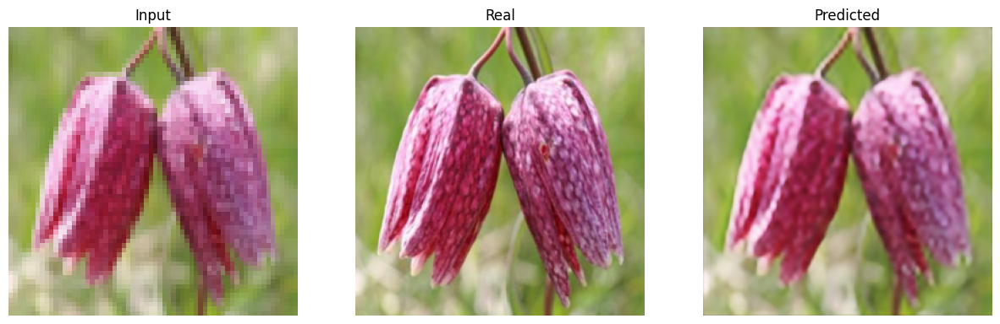

-----------------------------------------------------------
| End of epoch   5 | Time: 217.43s | Train psnr   27.229 | Train Loss    0.060 | Valid psnr   27.279 | Valid Loss    0.055 
-----------------------------------------------------------
| epoch   6 |    50/  369 batches | psnr   26.864
| epoch   6 |   100/  369 batches | psnr   27.164
| epoch   6 |   150/  369 batches | psnr   26.999
| epoch   6 |   200/  369 batches | psnr   27.246
| epoch   6 |   250/  369 batches | psnr   27.236
| epoch   6 |   300/  369 batches | psnr   27.164
| epoch   6 |   350/  369 batches | psnr   26.965
-----------------------------------------------------------
| End of epoch   6 | Time: 217.04s | Train psnr   26.729 | Train Loss    0.059 | Valid psnr   26.724 | Valid Loss    0.057 
-----------------------------------------------------------
| epoch   7 |    50/  369 batches | psnr   26.990
| epoch   7 |   100/  369 batches | psnr   27.164
| epoch   7 |   150/  369 batches | psnr   27.270
| epoch   7 

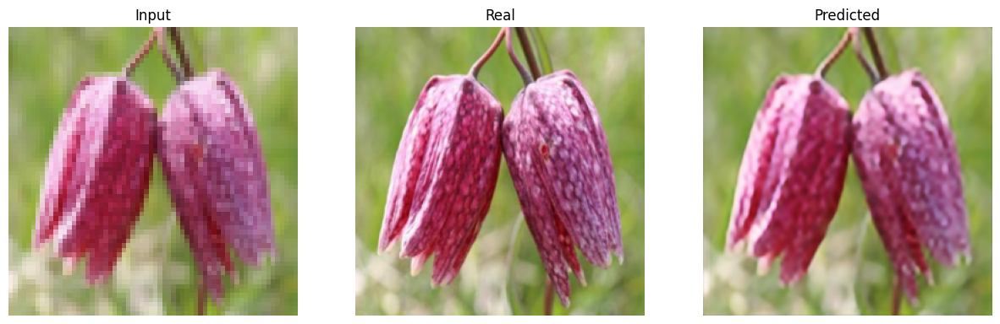

-----------------------------------------------------------
| End of epoch   7 | Time: 218.12s | Train psnr   27.629 | Train Loss    0.057 | Valid psnr   27.712 | Valid Loss    0.051 
-----------------------------------------------------------
| epoch   8 |    50/  369 batches | psnr   27.129
| epoch   8 |   100/  369 batches | psnr   27.190
| epoch   8 |   150/  369 batches | psnr   27.275
| epoch   8 |   200/  369 batches | psnr   27.406
| epoch   8 |   250/  369 batches | psnr   27.367
| epoch   8 |   300/  369 batches | psnr   27.713
| epoch   8 |   350/  369 batches | psnr   27.642


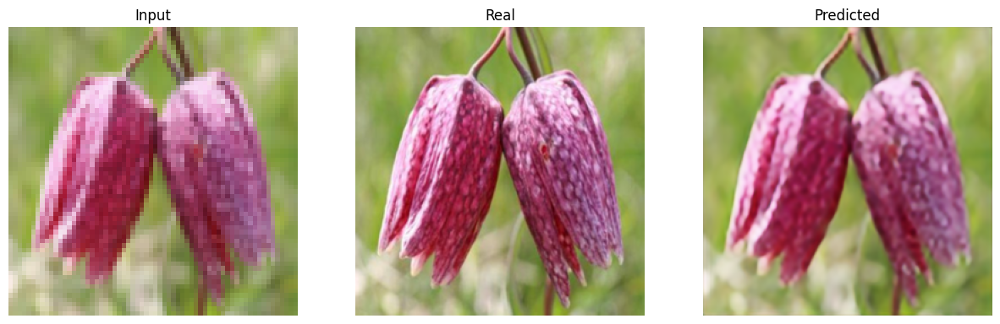

-----------------------------------------------------------
| End of epoch   8 | Time: 218.47s | Train psnr   27.680 | Train Loss    0.055 | Valid psnr   27.789 | Valid Loss    0.050 
-----------------------------------------------------------
| epoch   9 |    50/  369 batches | psnr   27.521
| epoch   9 |   100/  369 batches | psnr   27.701
| epoch   9 |   150/  369 batches | psnr   27.736
| epoch   9 |   200/  369 batches | psnr   27.499
| epoch   9 |   250/  369 batches | psnr   27.658
| epoch   9 |   300/  369 batches | psnr   27.538
| epoch   9 |   350/  369 batches | psnr   27.683
-----------------------------------------------------------
| End of epoch   9 | Time: 216.64s | Train psnr   27.486 | Train Loss    0.054 | Valid psnr   27.732 | Valid Loss    0.051 
-----------------------------------------------------------
| epoch  10 |    50/  369 batches | psnr   27.612
| epoch  10 |   100/  369 batches | psnr   27.516
| epoch  10 |   150/  369 batches | psnr   27.762
| epoch  10 

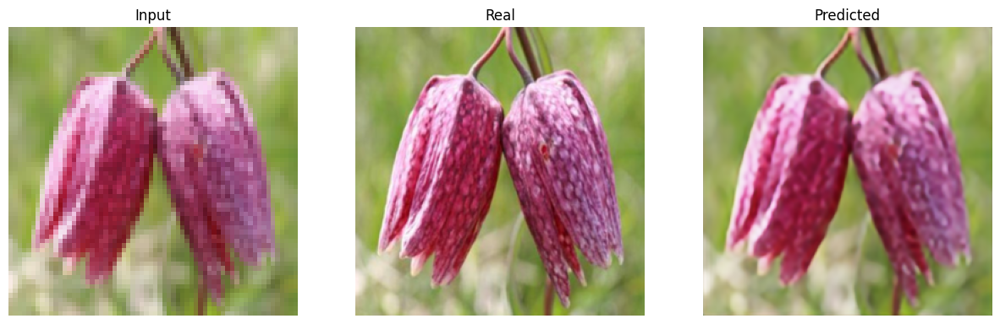

-----------------------------------------------------------
| End of epoch  10 | Time: 217.11s | Train psnr   27.819 | Train Loss    0.053 | Valid psnr   27.821 | Valid Loss    0.049 
-----------------------------------------------------------
| epoch  11 |    50/  369 batches | psnr   27.967
| epoch  11 |   100/  369 batches | psnr   27.918
| epoch  11 |   150/  369 batches | psnr   27.713
| epoch  11 |   200/  369 batches | psnr   27.960
| epoch  11 |   250/  369 batches | psnr   27.785
| epoch  11 |   300/  369 batches | psnr   27.737
| epoch  11 |   350/  369 batches | psnr   28.072


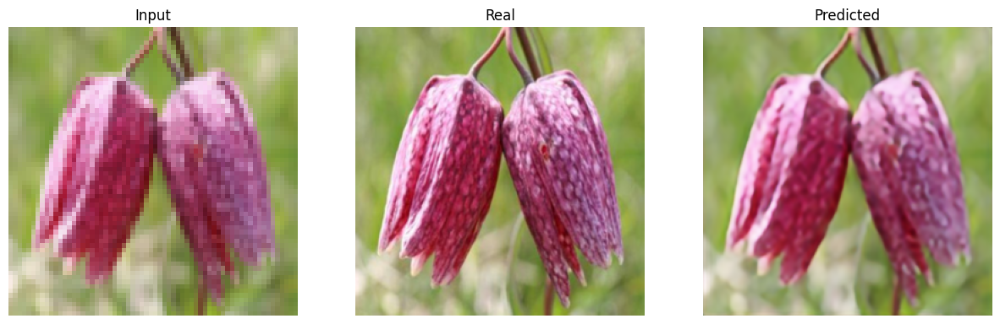

-----------------------------------------------------------
| End of epoch  11 | Time: 217.36s | Train psnr   27.709 | Train Loss    0.052 | Valid psnr   27.842 | Valid Loss    0.050 
-----------------------------------------------------------
| epoch  12 |    50/  369 batches | psnr   28.051
| epoch  12 |   100/  369 batches | psnr   27.899
| epoch  12 |   150/  369 batches | psnr   28.049
| epoch  12 |   200/  369 batches | psnr   27.876
| epoch  12 |   250/  369 batches | psnr   28.049
| epoch  12 |   300/  369 batches | psnr   27.905
| epoch  12 |   350/  369 batches | psnr   28.001


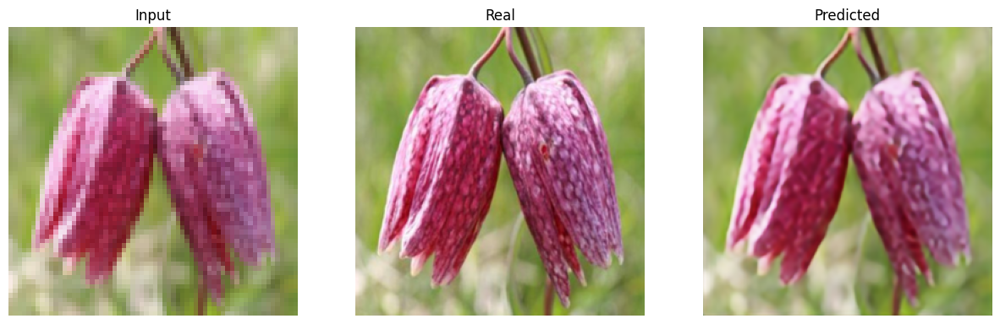

-----------------------------------------------------------
| End of epoch  12 | Time: 217.43s | Train psnr   28.226 | Train Loss    0.051 | Valid psnr   28.188 | Valid Loss    0.047 
-----------------------------------------------------------
| epoch  13 |    50/  369 batches | psnr   28.267
| epoch  13 |   100/  369 batches | psnr   27.989
| epoch  13 |   150/  369 batches | psnr   28.124
| epoch  13 |   200/  369 batches | psnr   28.102
| epoch  13 |   250/  369 batches | psnr   27.968
| epoch  13 |   300/  369 batches | psnr   27.992
| epoch  13 |   350/  369 batches | psnr   27.983
-----------------------------------------------------------
| End of epoch  13 | Time: 216.40s | Train psnr   28.188 | Train Loss    0.050 | Valid psnr   28.008 | Valid Loss    0.050 
-----------------------------------------------------------
| epoch  14 |    50/  369 batches | psnr   28.078
| epoch  14 |   100/  369 batches | psnr   28.242
| epoch  14 |   150/  369 batches | psnr   27.652
| epoch  14 

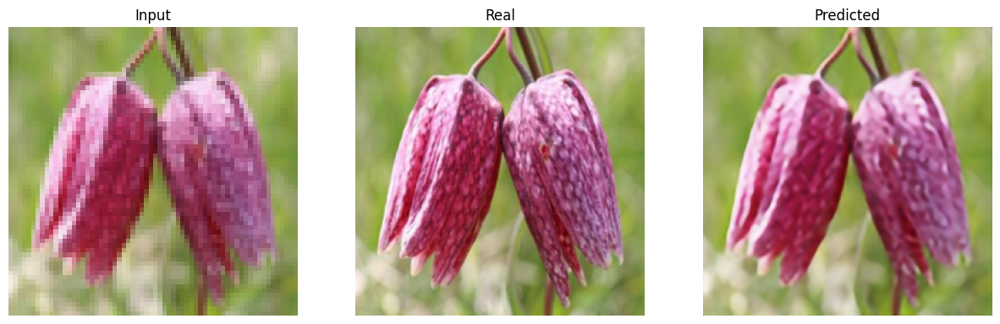

-----------------------------------------------------------
| End of epoch  16 | Time: 217.57s | Train psnr   28.356 | Train Loss    0.049 | Valid psnr   28.337 | Valid Loss    0.047 
-----------------------------------------------------------
| epoch  17 |    50/  369 batches | psnr   28.227
| epoch  17 |   100/  369 batches | psnr   28.293
| epoch  17 |   150/  369 batches | psnr   28.429
| epoch  17 |   200/  369 batches | psnr   28.488
| epoch  17 |   250/  369 batches | psnr   28.498
| epoch  17 |   300/  369 batches | psnr   28.456
| epoch  17 |   350/  369 batches | psnr   28.079


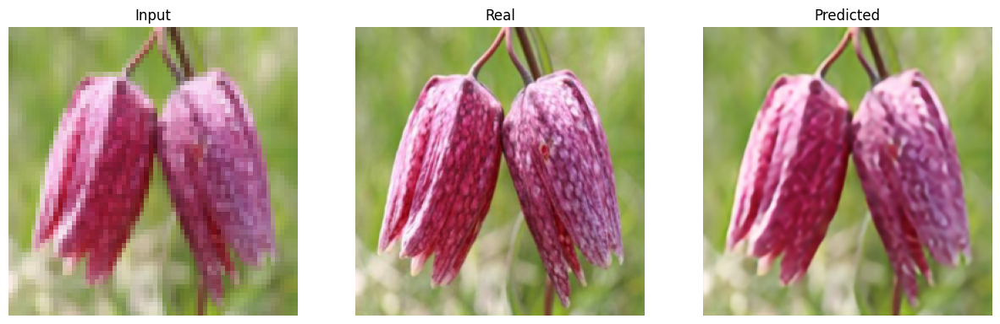

-----------------------------------------------------------
| End of epoch  17 | Time: 217.58s | Train psnr   28.278 | Train Loss    0.048 | Valid psnr   28.348 | Valid Loss    0.046 
-----------------------------------------------------------
| epoch  18 |    50/  369 batches | psnr   28.178
| epoch  18 |   100/  369 batches | psnr   28.379
| epoch  18 |   150/  369 batches | psnr   28.146
| epoch  18 |   200/  369 batches | psnr   28.501
| epoch  18 |   250/  369 batches | psnr   28.583
| epoch  18 |   300/  369 batches | psnr   28.483
| epoch  18 |   350/  369 batches | psnr   28.526
-----------------------------------------------------------
| End of epoch  18 | Time: 216.92s | Train psnr   28.235 | Train Loss    0.048 | Valid psnr   28.184 | Valid Loss    0.048 
-----------------------------------------------------------
| epoch  19 |    50/  369 batches | psnr   28.140
| epoch  19 |   100/  369 batches | psnr   28.414
| epoch  19 |   150/  369 batches | psnr   28.354
| epoch  19 

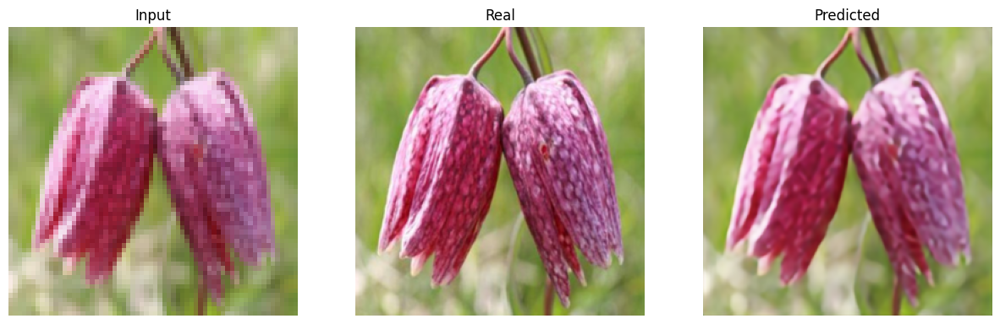

-----------------------------------------------------------
| End of epoch  19 | Time: 217.87s | Train psnr   28.506 | Train Loss    0.048 | Valid psnr   28.491 | Valid Loss    0.046 
-----------------------------------------------------------
| epoch  20 |    50/  369 batches | psnr   28.558
| epoch  20 |   100/  369 batches | psnr   28.517
| epoch  20 |   150/  369 batches | psnr   28.397
| epoch  20 |   200/  369 batches | psnr   28.480
| epoch  20 |   250/  369 batches | psnr   28.388
| epoch  20 |   300/  369 batches | psnr   28.397
| epoch  20 |   350/  369 batches | psnr   28.654


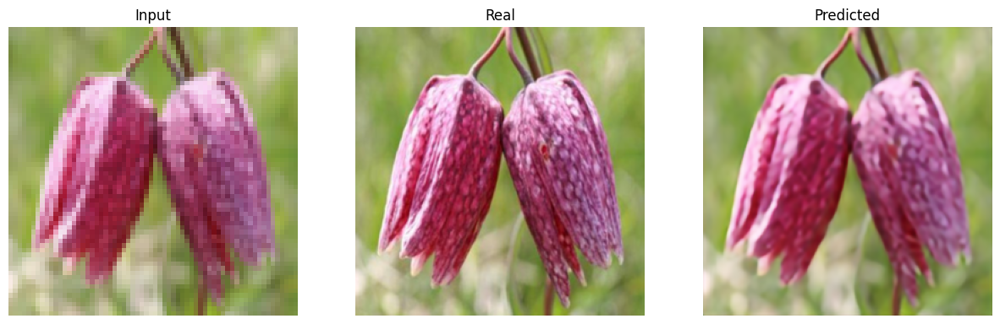

-----------------------------------------------------------
| End of epoch  20 | Time: 217.43s | Train psnr   28.515 | Train Loss    0.047 | Valid psnr   28.517 | Valid Loss    0.045 
-----------------------------------------------------------
| epoch  21 |    50/  369 batches | psnr   27.705
| epoch  21 |   100/  369 batches | psnr   28.191
| epoch  21 |   150/  369 batches | psnr   28.154
| epoch  21 |   200/  369 batches | psnr   28.422
| epoch  21 |   250/  369 batches | psnr   28.361
| epoch  21 |   300/  369 batches | psnr   28.436
| epoch  21 |   350/  369 batches | psnr   28.491
-----------------------------------------------------------
| End of epoch  21 | Time: 216.01s | Train psnr   28.223 | Train Loss    0.048 | Valid psnr   28.344 | Valid Loss    0.048 
-----------------------------------------------------------
| epoch  22 |    50/  369 batches | psnr   28.303
| epoch  22 |   100/  369 batches | psnr   28.638
| epoch  22 |   150/  369 batches | psnr   28.551
| epoch  22 

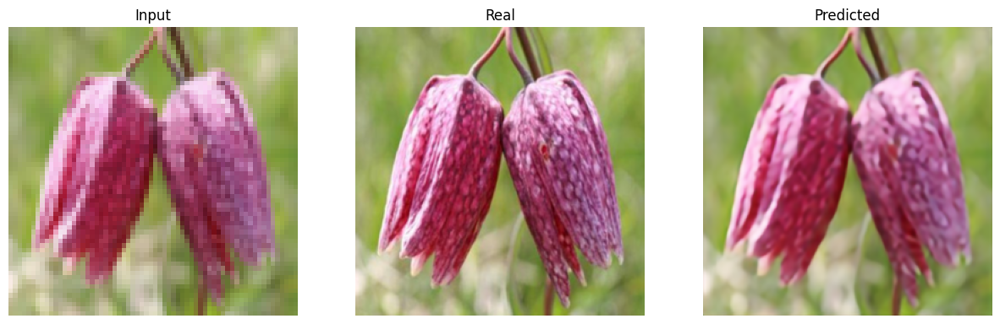

-----------------------------------------------------------
| End of epoch  24 | Time: 216.87s | Train psnr   28.904 | Train Loss    0.046 | Valid psnr   28.615 | Valid Loss    0.045 
-----------------------------------------------------------
| epoch  25 |    50/  369 batches | psnr   28.801
| epoch  25 |   100/  369 batches | psnr   28.943
| epoch  25 |   150/  369 batches | psnr   28.774
| epoch  25 |   200/  369 batches | psnr   28.562
| epoch  25 |   250/  369 batches | psnr   28.646
| epoch  25 |   300/  369 batches | psnr   28.561
| epoch  25 |   350/  369 batches | psnr   28.617
-----------------------------------------------------------
| End of epoch  25 | Time: 216.01s | Train psnr   28.674 | Train Loss    0.045 | Valid psnr   28.578 | Valid Loss    0.045 
-----------------------------------------------------------
| epoch  26 |    50/  369 batches | psnr   28.819
| epoch  26 |   100/  369 batches | psnr   28.233
| epoch  26 |   150/  369 batches | psnr   28.743
| epoch  26 

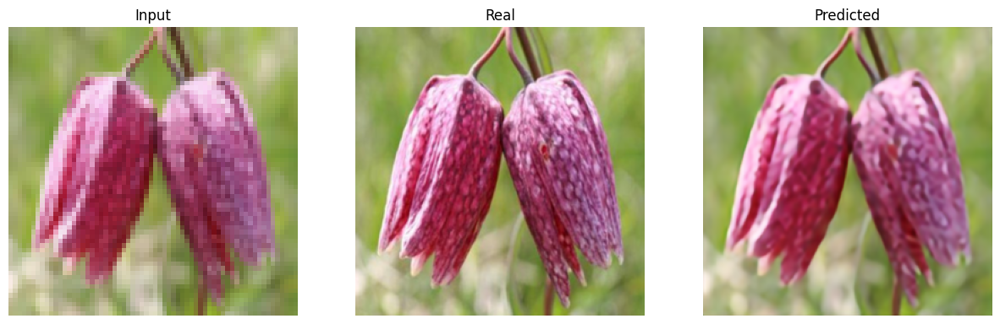

-----------------------------------------------------------
| End of epoch  27 | Time: 216.69s | Train psnr   28.883 | Train Loss    0.045 | Valid psnr   28.615 | Valid Loss    0.045 
-----------------------------------------------------------
| epoch  28 |    50/  369 batches | psnr   28.861
| epoch  28 |   100/  369 batches | psnr   28.666
| epoch  28 |   150/  369 batches | psnr   28.729
| epoch  28 |   200/  369 batches | psnr   28.675
| epoch  28 |   250/  369 batches | psnr   28.825
| epoch  28 |   300/  369 batches | psnr   28.935
| epoch  28 |   350/  369 batches | psnr   28.958
-----------------------------------------------------------
| End of epoch  28 | Time: 215.80s | Train psnr   28.400 | Train Loss    0.045 | Valid psnr   28.378 | Valid Loss    0.047 
-----------------------------------------------------------
| epoch  29 |    50/  369 batches | psnr   28.980
| epoch  29 |   100/  369 batches | psnr   28.852
| epoch  29 |   150/  369 batches | psnr   28.860
| epoch  29 

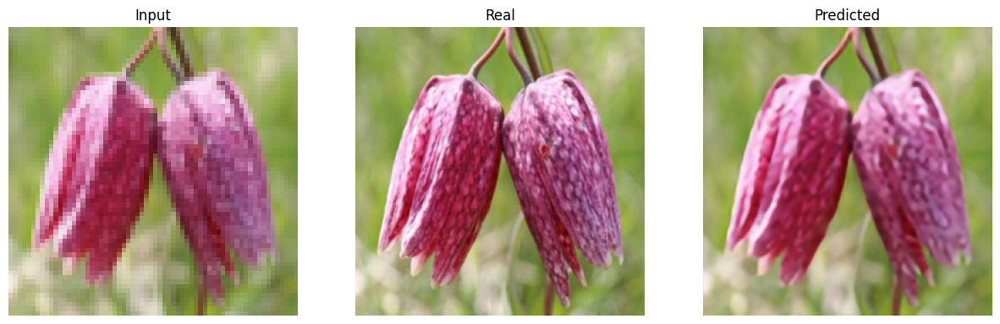

-----------------------------------------------------------
| End of epoch  29 | Time: 217.47s | Train psnr   28.668 | Train Loss    0.044 | Valid psnr   28.715 | Valid Loss    0.044 
-----------------------------------------------------------
| epoch  30 |    50/  369 batches | psnr   28.874
| epoch  30 |   100/  369 batches | psnr   28.809
| epoch  30 |   150/  369 batches | psnr   29.034
| epoch  30 |   200/  369 batches | psnr   28.705
| epoch  30 |   250/  369 batches | psnr   28.709
| epoch  30 |   300/  369 batches | psnr   28.894
| epoch  30 |   350/  369 batches | psnr   28.885


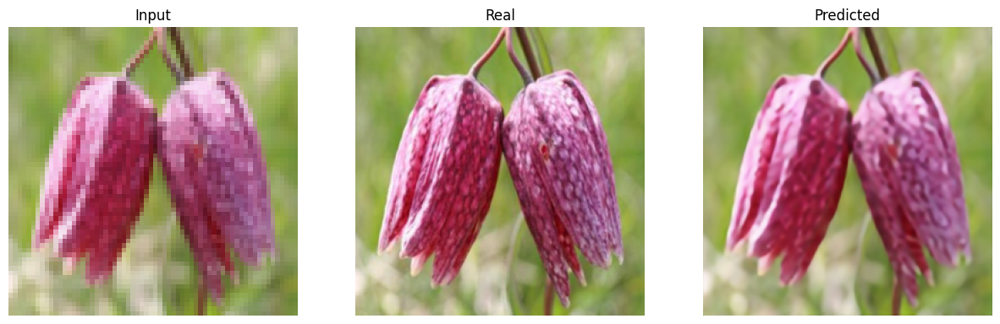

-----------------------------------------------------------
| End of epoch  30 | Time: 216.86s | Train psnr   29.028 | Train Loss    0.044 | Valid psnr   28.760 | Valid Loss    0.044 
-----------------------------------------------------------
| epoch  31 |    50/  369 batches | psnr   28.865
| epoch  31 |   100/  369 batches | psnr   28.873
| epoch  31 |   150/  369 batches | psnr   28.665
| epoch  31 |   200/  369 batches | psnr   28.999
| epoch  31 |   250/  369 batches | psnr   28.902
| epoch  31 |   300/  369 batches | psnr   28.811
| epoch  31 |   350/  369 batches | psnr   28.846
-----------------------------------------------------------
| End of epoch  31 | Time: 215.58s | Train psnr   29.247 | Train Loss    0.044 | Valid psnr   28.707 | Valid Loss    0.045 
-----------------------------------------------------------
| epoch  32 |    50/  369 batches | psnr   28.850
| epoch  32 |   100/  369 batches | psnr   28.975
| epoch  32 |   150/  369 batches | psnr   28.853
| epoch  32 

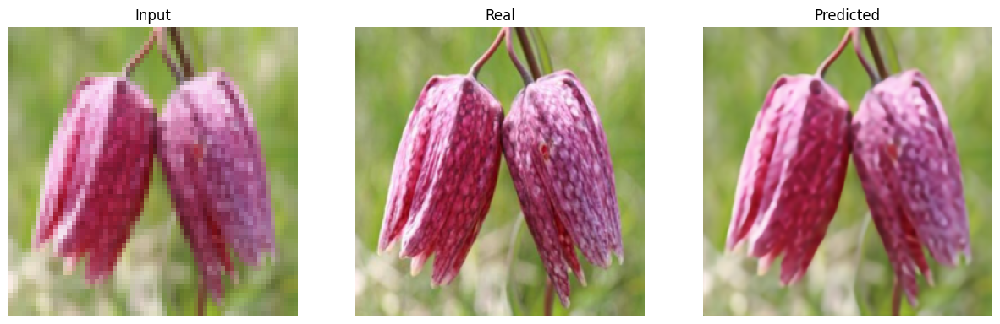

-----------------------------------------------------------
| End of epoch  32 | Time: 216.64s | Train psnr   28.848 | Train Loss    0.044 | Valid psnr   28.770 | Valid Loss    0.044 
-----------------------------------------------------------
| epoch  33 |    50/  369 batches | psnr   28.985
| epoch  33 |   100/  369 batches | psnr   29.103
| epoch  33 |   150/  369 batches | psnr   28.850
| epoch  33 |   200/  369 batches | psnr   28.904
| epoch  33 |   250/  369 batches | psnr   28.884
| epoch  33 |   300/  369 batches | psnr   28.997
| epoch  33 |   350/  369 batches | psnr   29.072
-----------------------------------------------------------
| End of epoch  33 | Time: 215.99s | Train psnr   28.943 | Train Loss    0.043 | Valid psnr   28.696 | Valid Loss    0.044 
-----------------------------------------------------------
| epoch  34 |    50/  369 batches | psnr   29.129
| epoch  34 |   100/  369 batches | psnr   28.809
| epoch  34 |   150/  369 batches | psnr   28.929
| epoch  34 

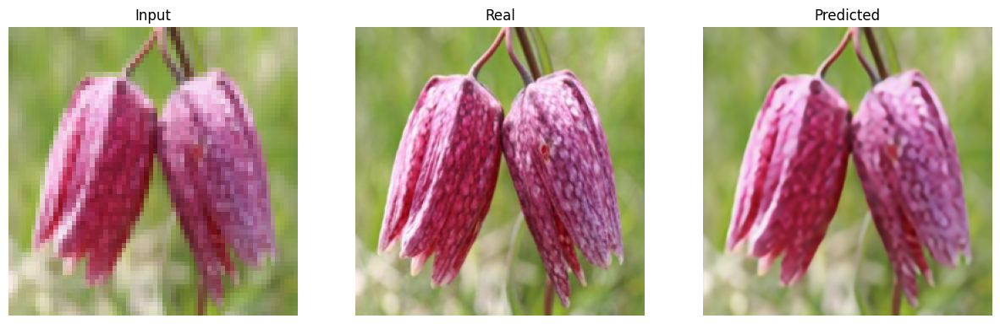

-----------------------------------------------------------
| End of epoch  34 | Time: 217.15s | Train psnr   28.832 | Train Loss    0.043 | Valid psnr   28.775 | Valid Loss    0.044 
-----------------------------------------------------------
| epoch  35 |    50/  369 batches | psnr   28.979
| epoch  35 |   100/  369 batches | psnr   29.157
| epoch  35 |   150/  369 batches | psnr   28.919
| epoch  35 |   200/  369 batches | psnr   28.918
| epoch  35 |   250/  369 batches | psnr   28.844
| epoch  35 |   300/  369 batches | psnr   29.160
| epoch  35 |   350/  369 batches | psnr   28.987


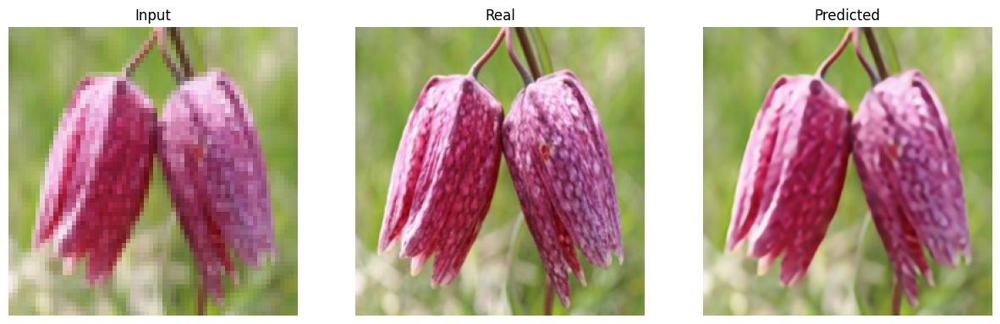

-----------------------------------------------------------
| End of epoch  35 | Time: 216.92s | Train psnr   29.040 | Train Loss    0.043 | Valid psnr   28.911 | Valid Loss    0.043 
-----------------------------------------------------------
| epoch  36 |    50/  369 batches | psnr   29.058
| epoch  36 |   100/  369 batches | psnr   29.245
| epoch  36 |   150/  369 batches | psnr   29.123
| epoch  36 |   200/  369 batches | psnr   28.987
| epoch  36 |   250/  369 batches | psnr   28.925
| epoch  36 |   300/  369 batches | psnr   28.936
| epoch  36 |   350/  369 batches | psnr   29.022
-----------------------------------------------------------
| End of epoch  36 | Time: 216.10s | Train psnr   29.362 | Train Loss    0.043 | Valid psnr   28.900 | Valid Loss    0.043 
-----------------------------------------------------------
| epoch  37 |    50/  369 batches | psnr   29.211
| epoch  37 |   100/  369 batches | psnr   28.959
| epoch  37 |   150/  369 batches | psnr   29.062
| epoch  37 

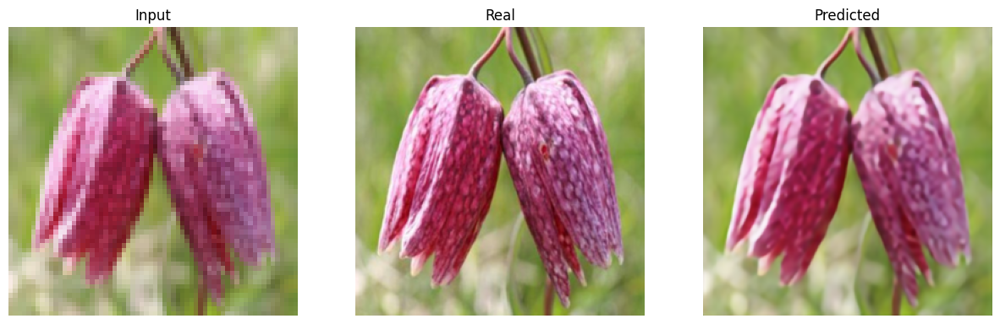

-----------------------------------------------------------
| End of epoch  45 | Time: 218.10s | Train psnr   29.295 | Train Loss    0.042 | Valid psnr   28.922 | Valid Loss    0.043 
-----------------------------------------------------------
| epoch  46 |    50/  369 batches | psnr   29.242
| epoch  46 |   100/  369 batches | psnr   29.092
| epoch  46 |   150/  369 batches | psnr   28.947
| epoch  46 |   200/  369 batches | psnr   29.365
| epoch  46 |   250/  369 batches | psnr   29.380
| epoch  46 |   300/  369 batches | psnr   29.245
| epoch  46 |   350/  369 batches | psnr   29.152


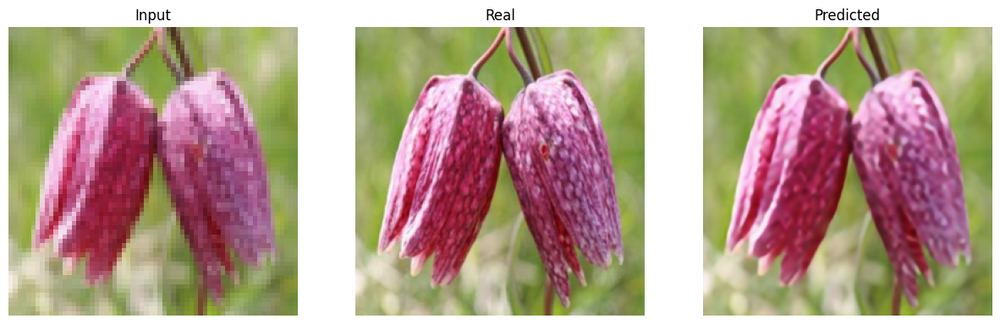

-----------------------------------------------------------
| End of epoch  46 | Time: 216.74s | Train psnr   29.337 | Train Loss    0.042 | Valid psnr   29.043 | Valid Loss    0.042 
-----------------------------------------------------------
| epoch  47 |    50/  369 batches | psnr   29.215
| epoch  47 |   100/  369 batches | psnr   29.299
| epoch  47 |   150/  369 batches | psnr   28.998
| epoch  47 |   200/  369 batches | psnr   29.263
| epoch  47 |   250/  369 batches | psnr   29.404
| epoch  47 |   300/  369 batches | psnr   29.145
| epoch  47 |   350/  369 batches | psnr   29.168
-----------------------------------------------------------
| End of epoch  47 | Time: 216.14s | Train psnr   29.140 | Train Loss    0.042 | Valid psnr   28.991 | Valid Loss    0.042 
-----------------------------------------------------------
| epoch  48 |    50/  369 batches | psnr   28.952
| epoch  48 |   100/  369 batches | psnr   29.234
| epoch  48 |   150/  369 batches | psnr   29.321
| epoch  48 

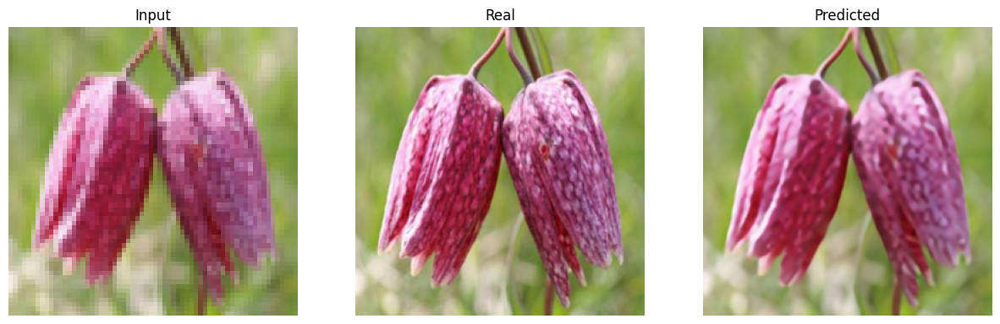

-----------------------------------------------------------
| End of epoch  49 | Time: 216.90s | Train psnr   28.950 | Train Loss    0.042 | Valid psnr   29.066 | Valid Loss    0.041 
-----------------------------------------------------------
| epoch  50 |    50/  369 batches | psnr   29.158
| epoch  50 |   100/  369 batches | psnr   29.275
| epoch  50 |   150/  369 batches | psnr   29.363
| epoch  50 |   200/  369 batches | psnr   29.322
| epoch  50 |   250/  369 batches | psnr   29.110
| epoch  50 |   300/  369 batches | psnr   29.202
| epoch  50 |   350/  369 batches | psnr   29.331
-----------------------------------------------------------
| End of epoch  50 | Time: 215.83s | Train psnr   29.530 | Train Loss    0.041 | Valid psnr   28.991 | Valid Loss    0.042 
-----------------------------------------------------------


<ipython-input-14-9140fde4fd84>:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))


In [17]:
import torch.optim as optim

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
SR_unet_model = SR_Unet().to(device)
SR_unet_model.to(device)

criterion = nn.L1Loss()

optimizer = optim.Adam(SR_unet_model.parameters(), lr=1e-4, betas=[0.5,0.999])

save_model = '/kaggle/working/UNET'
os.makedirs(save_model, exist_ok = True)

EPOCHS = 50
SR_unet_model, metrics = train(
    SR_unet_model, 'SR_unet_model', save_model, optimizer, criterion, train_loader, test_loader, EPOCHS, device
)

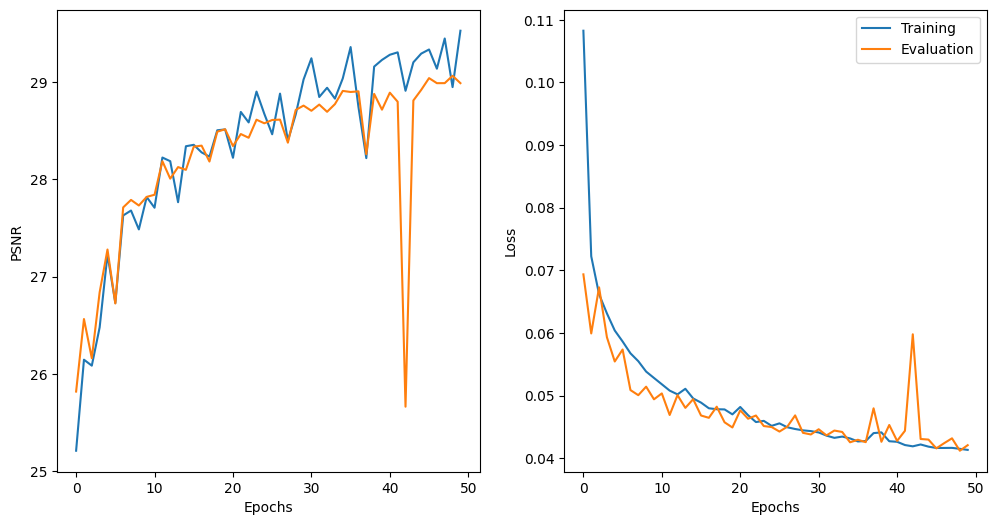

In [18]:
plot_result(
    EPOCHS,
    metrics["train_psnr"],
    metrics["valid_psnr"],
    metrics["train_loss"],
    metrics["valid_loss"]
)

In [19]:
test_psnr, test_loss = evaluate_epoch(SR_unet_model, criterion, test_loader, device)
test_psnr, test_loss

(tensor(29.0665, device='cuda:0'), 0.04120324679264208)

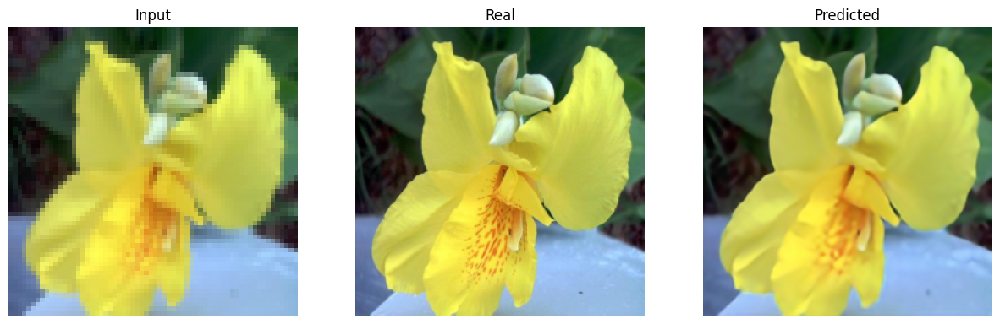

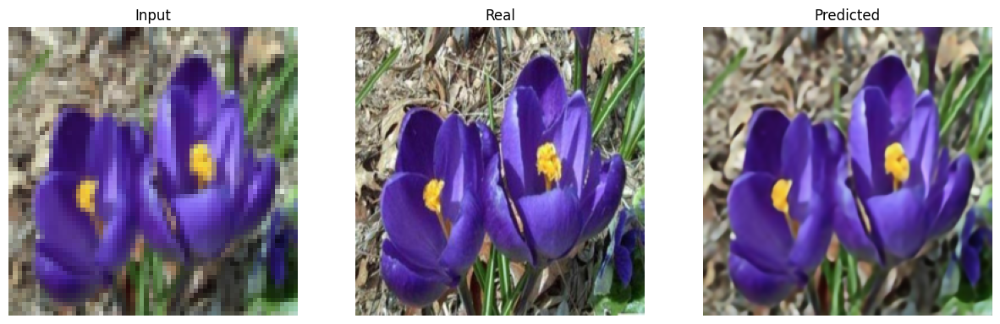

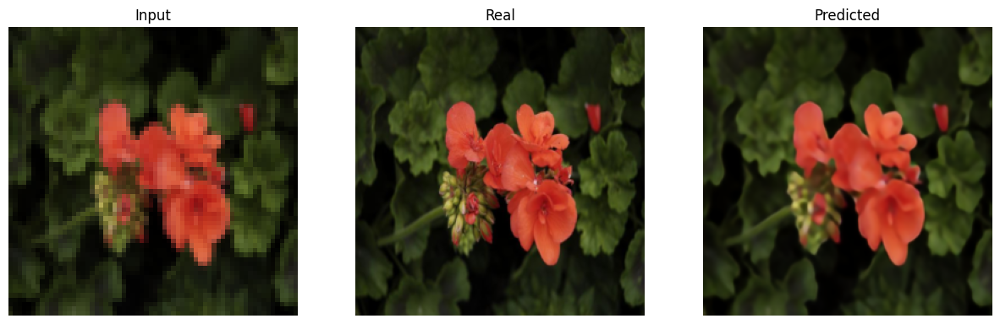

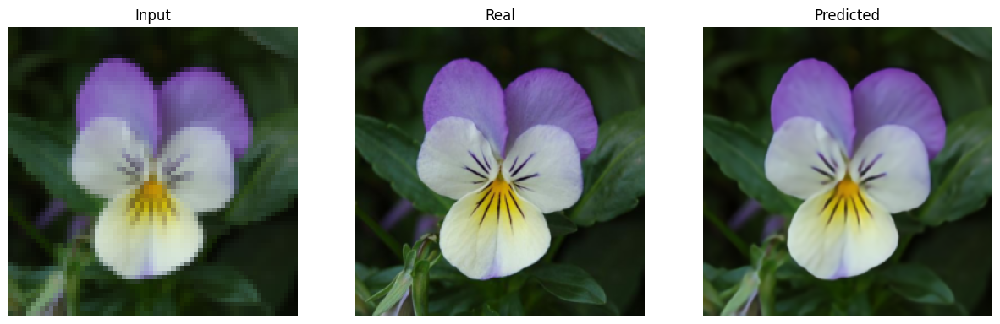

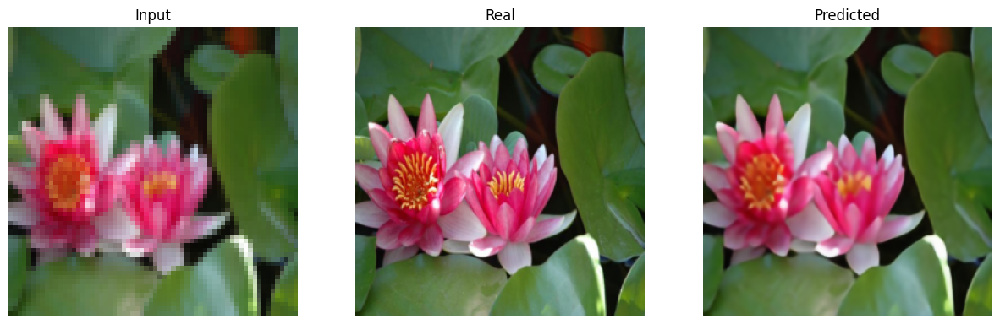

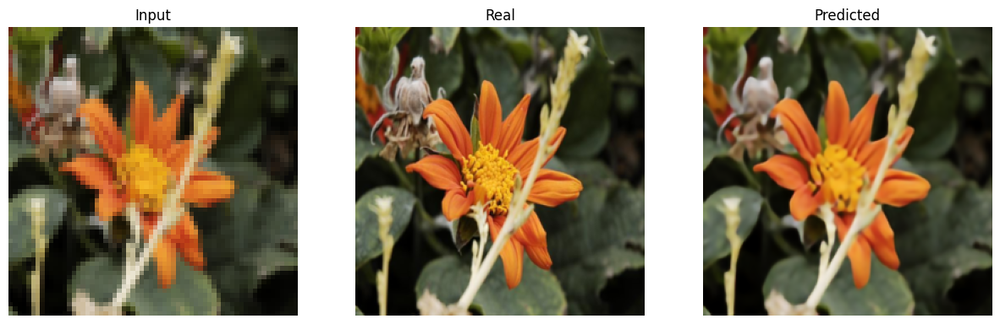

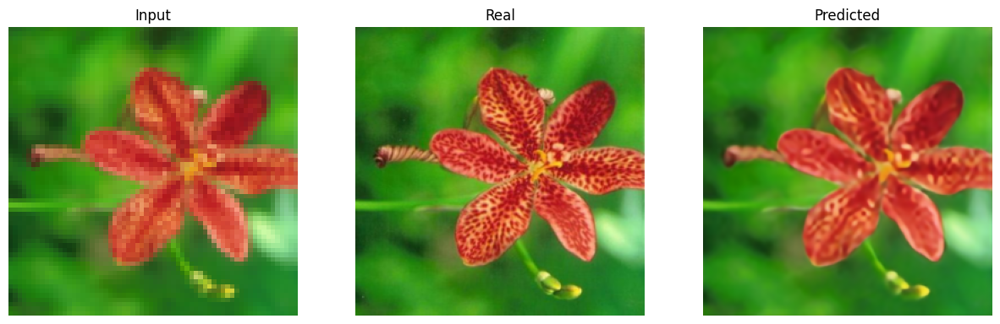

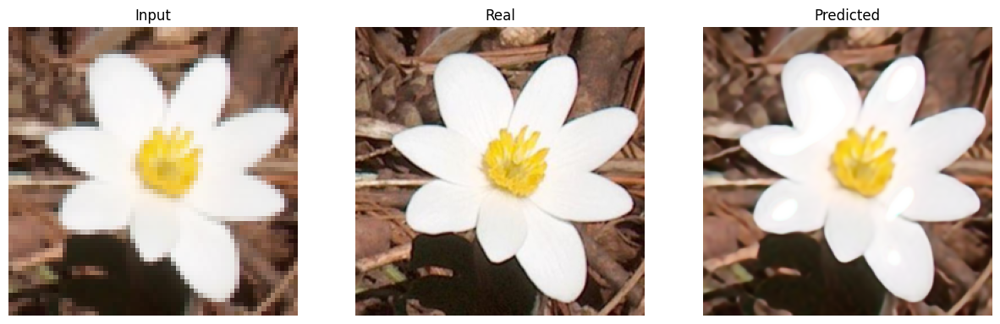

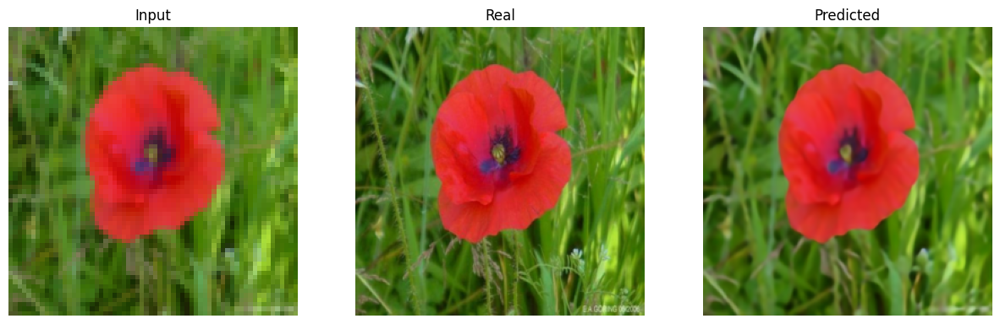

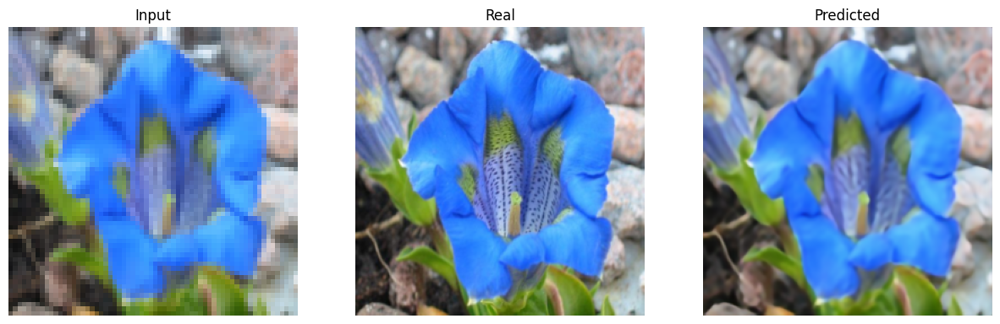

In [20]:
predict_and_display(SR_unet_model, train_loader, device)

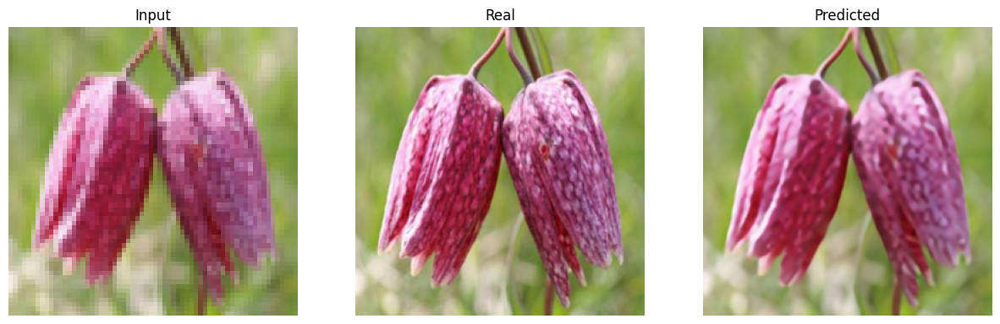

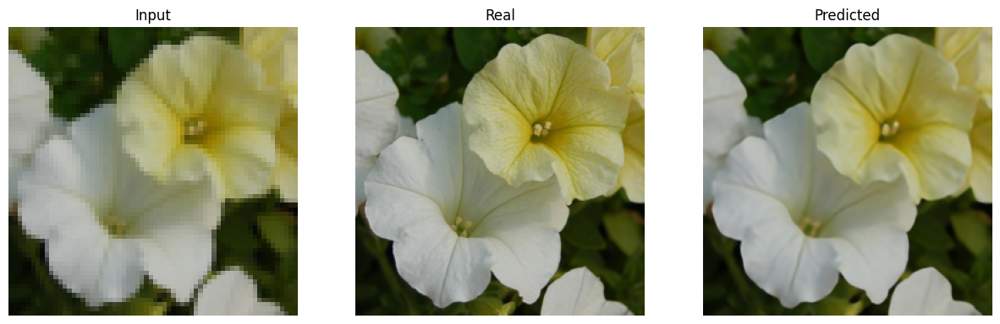

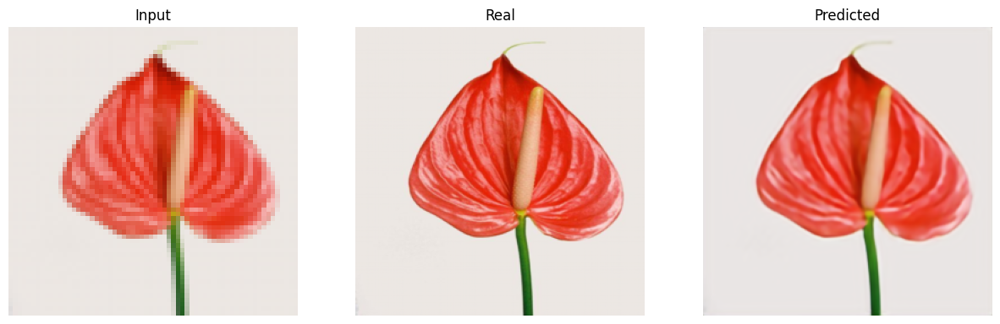

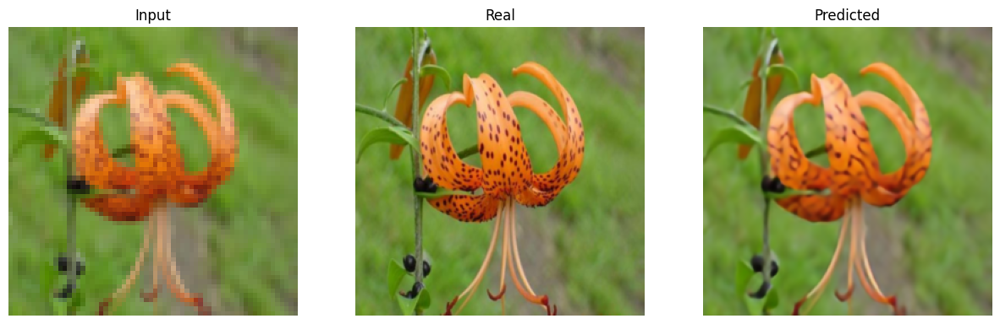

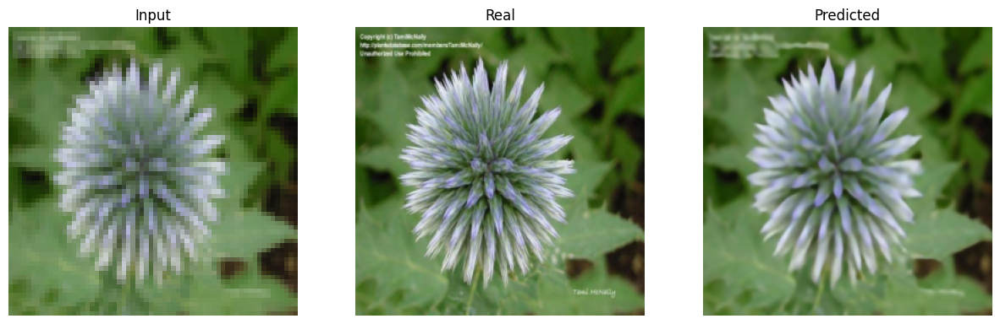

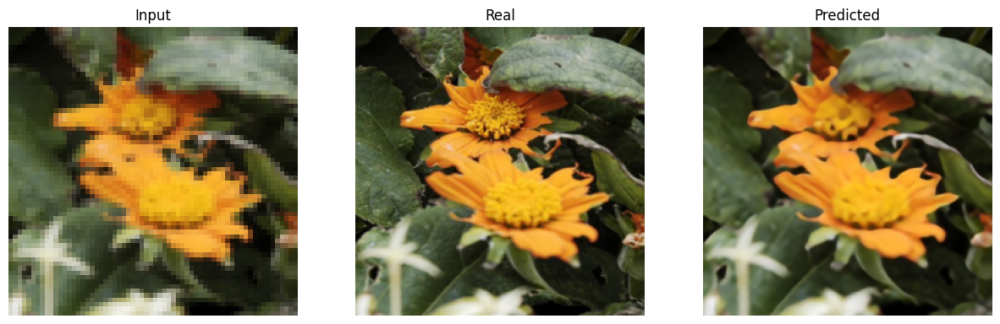

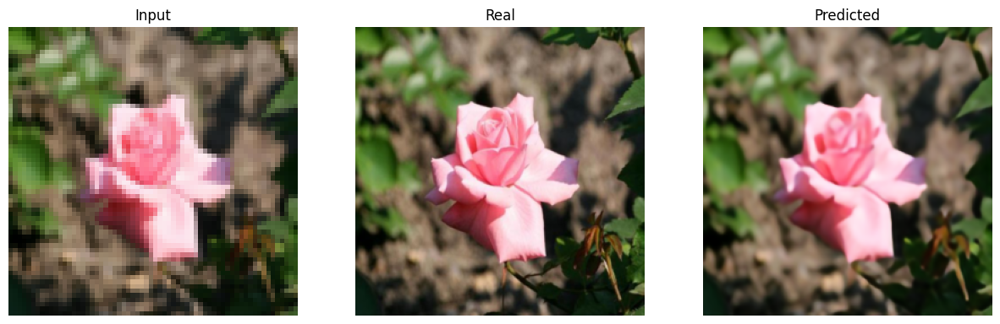

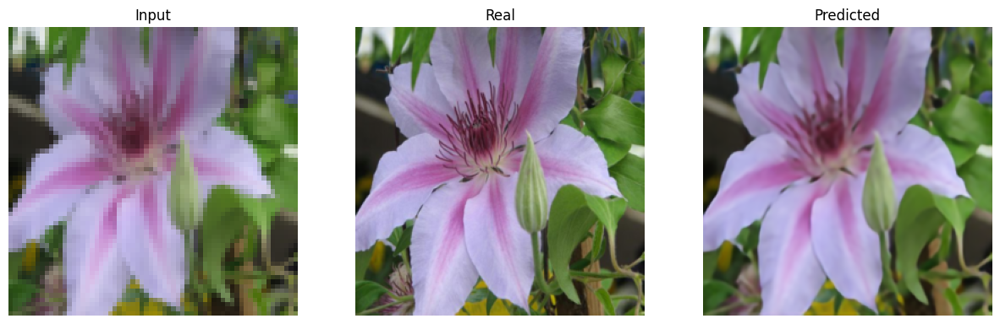

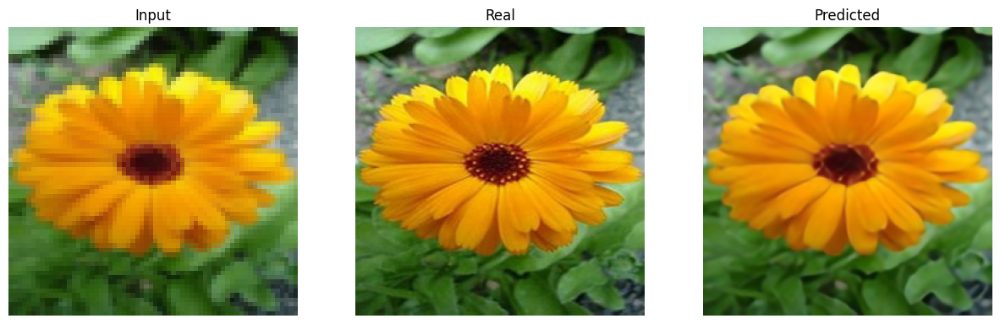

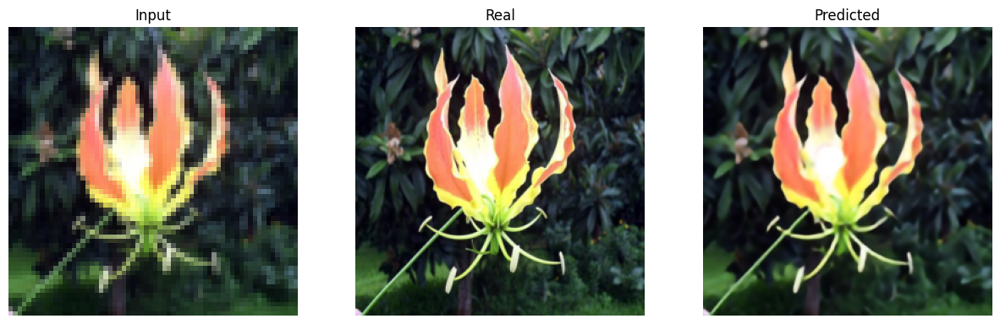

In [21]:
predict_and_display(SR_unet_model, test_loader, device)